<a href="https://colab.research.google.com/github/paurnavi25/ML-Virtual_Internship_Tasks/blob/main/Task3_Paurnavi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import io
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

  df = pd.read_csv(io.StringIO(uploaded[fn].decode('utf-8')))

df.head()


Saving Dataset .csv to Dataset .csv
User uploaded file "Dataset .csv" with length 2249716 bytes


,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


In [ ]:
!pip install -q folium
import folium
from folium.plugins import MarkerCluster, HeatMap

In [ ]:
df['Latitude'] = pd.to_numeric(df['Latitude'], errors='coerce')
df['Longitude'] = pd.to_numeric(df['Longitude'], errors='coerce')

# Drop rows without coords
df_loc = df.dropna(subset=['Latitude', 'Longitude']).copy()
df_loc.reset_index(drop=True, inplace=True)

print("Original rows:", df.shape[0], "Rows with coords:", df_loc.shape[0])


Original rows: 9551 Rows with coords: 9551


In [ ]:
center_lat = df_loc['Latitude'].mean()
center_lon = df_loc['Longitude'].mean()

m = folium.Map(location=[center_lat, center_lon], zoom_start=5)  # adjust zoom_start per country
marker_cluster = MarkerCluster().add_to(m)

for idx, row in df_loc.iterrows():
    popup = f"{row.get('Restaurant Name','')}<br>Rating: {row.get('Aggregate rating','')}" \
            f"<br>{row.get('Cuisines','')}"
    folium.Marker(location=[row['Latitude'], row['Longitude']],
                  popup=popup, icon=folium.Icon(icon='cutlery', prefix='fa')).add_to(marker_cluster)

# Save map as HTML and display
m.save('restaurants_map_cluster.html')
m


In [ ]:
coords = df_loc[['Latitude','Longitude']].values.tolist()

In [ ]:
m2 = folium.Map(location=[center_lat, center_lon], zoom_start=5)
HeatMap(coords, radius=8, blur=10, min_opacity=0.2).add_to(m2)
m2.save('restaurants_heatmap.html')
m2

In [ ]:
city_stats = df_loc.groupby('City').agg(
    restaurants_count = ('Restaurant Name','count'),
    avg_rating = ('Aggregate rating','mean'),
    avg_cost = ('Average Cost for two','mean')
).sort_values('restaurants_count', ascending=False).reset_index()

city_stats.head(20)


,City,restaurants_count,avg_rating,avg_cost
0,New Delhi,5473,2.438845,596.088069
1,Gurgaon,1118,2.651431,714.016100
2,Noida,1080,2.036204,539.490741
3,Faridabad,251,1.866932,447.609562
4,Ghaziabad,25,2.852000,602.000000
5,Bhubaneshwar,21,3.980952,678.571429
6,Lucknow,21,4.195238,859.523810
7,Guwahati,21,4.190476,821.428571
8,Ahmedabad,21,4.161905,857.142857
9,Amritsar,21,3.685714,480.952381


In [ ]:
city_stats.to_csv('city_stats.csv', index=False)


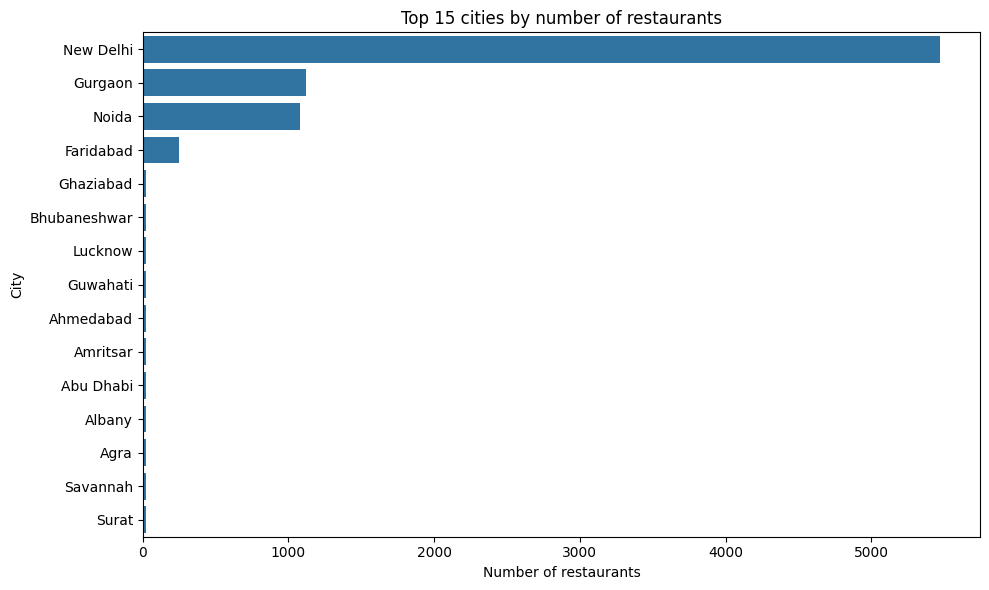

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
top_cities = city_stats.head(15)
sns.barplot(data=top_cities, x='restaurants_count', y='City')
plt.title('Top 15 cities by number of restaurants')
plt.xlabel('Number of restaurants')
plt.tight_layout()
plt.show()

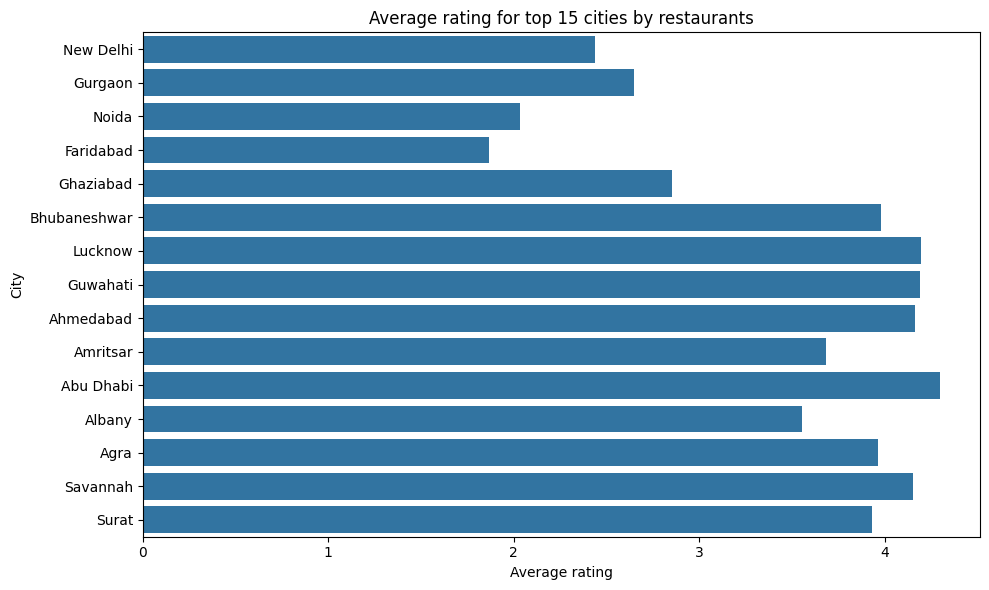

In [ ]:
plt.figure(figsize=(10,6))
sns.barplot(data=top_cities, x='avg_rating', y='City')
plt.title('Average rating for top 15 cities by restaurants')
plt.xlabel('Average rating')
plt.tight_layout()
plt.show()

In [ ]:
if 'Locality' in df_loc.columns:
    locality_stats = df_loc.groupby('Locality').agg(
        restaurants_count=('Restaurant Name','count'),
        avg_rating=('Aggregate rating','mean'),
        avg_cost=('Average Cost for two','mean')
    ).sort_values('restaurants_count', ascending=False).reset_index()
    locality_stats.head(20).to_csv('locality_stats_top20.csv', index=False)
    locality_stats.head(20)
else:
    print("Locality column not present")


In [ ]:
city_name = 'Pasay City'
city_df = df_loc[df_loc['City'].str.lower()==city_name.lower()].copy()

if city_df.shape[0] > 0:
    center_lat_city = city_df['Latitude'].mean()
    center_lon_city = city_df['Longitude'].mean()
    mc = folium.Map(location=[center_lat_city, center_lon_city], zoom_start=12)
    mc_cluster = MarkerCluster().add_to(mc)
    for _, r in city_df.iterrows():
        popup = f"{r.get('Restaurant Name','')} | Rating: {r.get('Aggregate rating','')}"
        folium.Marker([r['Latitude'], r['Longitude']], popup=popup).add_to(mc_cluster)
    mc.save(f'{city_name}_restaurants_map.html')
    mc
else:
    print("No restaurants in this city in your data.")

In [ ]:
df_loc['Cuisines'] = df_loc['Cuisines'].astype(str).str.lower().str.replace('/', ' ').str.replace('&',' and ')

# Split into rows
s = df_loc['Cuisines'].str.split(',').explode().str.strip()
cuisine_counts = s.value_counts().reset_index()
cuisine_counts.columns = ['cuisine','count']
cuisine_counts.head(20)

# Top cuisines overall
cuisine_counts.head(20).to_csv('top_cuisines.csv', index=False)


In [ ]:
df_exploded = df_loc.assign(cuisine = df_loc['Cuisines'].str.split(',')).explode('cuisine')
df_exploded['cuisine'] = df_exploded['cuisine'].str.strip()
city_cuisine = df_exploded.groupby(['City','cuisine']).size().reset_index(name='count')
# top cuisines per city example
city_cuisine[city_cuisine['City'].str.lower()=='mumbai'].sort_values('count', ascending=False).head(10)


,City,cuisine,count
1109,Mumbai,italian,9
1104,Mumbai,desserts,8
1102,Mumbai,chinese,7
1101,Mumbai,cafe,6
1106,Mumbai,fast food,6
1114,Mumbai,north indian,6
1119,Mumbai,tea,4
1095,Mumbai,american,3
1103,Mumbai,continental,3
1100,Mumbai,burger,3


from matplotlib import pyplot as plt
_df_0['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['count'].plot(kind='hist', bins=20, title='count')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2.plot(kind='scatter', x='index', y='count', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_3['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_4['count'].plot(kind='line', figsize=(8, 4), title='count')
plt.gca().spines[['top', 'right']].set_visible(False)

In [ ]:
min_restaurants = 20
good_cities = city_stats[city_stats['restaurants_count']>=min_restaurants].sort_values('avg_rating', ascending=False)
good_cities.head(20).to_csv('high_avg_rating_cities.csv', index=False)
good_cities.head(20)


,City,restaurants_count,avg_rating,avg_cost
36,London,20,4.535000,64.50000
70,Orlando,20,4.475000,40.25000
53,Tampa Bay,20,4.410000,34.75000
61,Rest of Hawaii,20,4.410000,31.75000
28,Bangalore,20,4.375000,1232.50000
32,Dubai,20,4.370000,211.75000
21,Chennai,20,4.315000,1085.00000
19,Ankara,20,4.305000,87.25000
10,Abu Dhabi,20,4.300000,182.00000
17,Auckland,20,4.275000,68.25000


In [ ]:
from sklearn.cluster import KMeans
coords = df_loc[['Latitude','Longitude']].values
k = 8
km = KMeans(n_clusters=k, random_state=42)
labels = km.fit_predict(coords)
df_loc['cluster'] = labels

# Plot clusters on a map
map_clusters = folium.Map(location=[center_lat, center_lon], zoom_start=5)
colors = ['red','blue','green','purple','orange','darkred','lightblue','cadetblue','beige','black']
for i, row in df_loc.iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']],
                        radius=3,
                        color=colors[int(row['cluster'])%len(colors)],
                        fill=True).add_to(map_clusters)
map_clusters.save('location_clusters.html')
map_clusters


In [ ]:
city_stats.to_csv('city_stats.csv', index=False)
if 'locality_stats' in globals():
    locality_stats.to_csv('locality_stats.csv', index=False)
df_loc.to_csv('df_loc_for_maps.csv', index=False)



**Insights** (Mumbai Cuisine Distribution)

- Italian is the most common cuisine, showing high demand for Western food.

- Desserts and cafés are very popular, indicating a strong cafe culture in Mumbai.

- Chinese and North Indian cuisines are widely available and highly preferred.

- Fast food options are common due to Mumbai’s fast-paced lifestyle.

- Overall, the cuisine spread reflects Mumbai’s diverse and multicultural food culture.

**Insights**

- City Lucknow has the highest number of restaurants; however city London has a higher average rating despite fewer restaurants - this may indicate higher quality in London.